In [ ]:
! pip install -q kaggle

In [ ]:
from google.colab import files

files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"siddharthp02","key":"d7becfe07444dbfd7d090ab085d148f5"}'}

In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets list

ref                                                            title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
salvatorerastelli/spotify-and-youtube                          Spotify and Youtube                                   9MB  2023-03-20 15:43:25          11281        394  1.0              
arnabchaki/data-science-salaries-2023                          Data Science Salaries 2023  💸                        25KB  2023-04-13 09:55:16           5408        133  1.0              
erdemtaha/cancer-data                                          Cancer Data                                          49KB  2023-03-22 07:57:00           5713        115  1.0              
evangower/premier-league-2022-2023                             Pr

In [ ]:
!kaggle datasets download -d feyzazkefe/olid-dataset

100% 864k/864k [00:00<00:00, 1.31MB/s]
100% 864k/864k [00:00<00:00, 1.31MB/s]


In [ ]:
! mkdir data
! unzip /content/olid-dataset.zip -d data

Archive:  /content/olid-dataset.zip
  inflating: data/README.txt         
  inflating: data/labels-levela.csv  
  inflating: data/labels-levelb.csv  
  inflating: data/labels-levelc.csv  
  inflating: data/olid-annotation.txt  
  inflating: data/olid-training-v1.0.tsv  
  inflating: data/testset-levela.tsv  
  inflating: data/testset-levelb.tsv  
  inflating: data/testset-levelc.tsv  


In [ ]:
!pip install torch_geometric

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import networkx as nx
import torch
from torch_geometric.nn import GCNConv, Sequential
from torch_geometric.data import Data, DataLoader
from sklearn.metrics.pairwise import cosine_similarity
from gensim.models import Word2Vec
import numpy as np

In [ ]:
train_data=pd.read_csv('/content/data/olid-training-v1.0.tsv', delimiter='\t', encoding='utf-8')

In [ ]:
train_data

,id,tweet,subtask_a,subtask_b,subtask_c
0,86426,@USER She should ask a few native Americans wh...,OFF,UNT,NaN
1,90194,@USER @USER Go home you’re drunk!!! @USER #MAG...,OFF,TIN,IND
2,16820,Amazon is investigating Chinese employees who ...,NOT,NaN,NaN
3,62688,"@USER Someone should'veTaken"" this piece of sh...",OFF,UNT,NaN
4,43605,@USER @USER Obama wanted liberals &amp; illega...,NOT,NaN,NaN
...,...,...,...,...,...
13235,95338,@USER Sometimes I get strong vibes from people...,OFF,TIN,IND
13236,67210,Benidorm ✅ Creamfields ✅ Maga ✅ Not too sh...,NOT,NaN,NaN
13237,82921,@USER And why report this garbage. We don't g...,OFF,TIN,OTH
13238,27429,@USER Pussy,OFF,UNT,NaN


In [ ]:
train_data[['id','tweet','subtask_a']]

,id,tweet,subtask_a
0,86426,@USER She should ask a few native Americans wh...,OFF
1,90194,@USER @USER Go home you’re drunk!!! @USER #MAG...,OFF
2,16820,Amazon is investigating Chinese employees who ...,NOT
3,62688,"@USER Someone should'veTaken"" this piece of sh...",OFF
4,43605,@USER @USER Obama wanted liberals &amp; illega...,NOT
...,...,...,...
13235,95338,@USER Sometimes I get strong vibes from people...,OFF
13236,67210,Benidorm ✅ Creamfields ✅ Maga ✅ Not too sh...,NOT
13237,82921,@USER And why report this garbage. We don't g...,OFF
13238,27429,@USER Pussy,OFF


In [ ]:
# Construct the tweet node features and labels
X = train_data['tweet'].tolist() # tweet text
y_a = train_data['subtask_a'].tolist() # offensive/not offensive labels
y_b = train_data['subtask_b'].tolist() # targeted/at others labels
y_c = train_data['subtask_c'].tolist() # individual/group/other labels


In [ ]:
X

['@USER She should ask a few native Americans what their take on this is.',
 '@USER @USER Go home you’re drunk!!! @USER #MAGA #Trump2020 👊🇺🇸👊 URL',
 'Amazon is investigating Chinese employees who are selling internal data to third-party sellers looking for an edge in the competitive marketplace. URL #Amazon #MAGA #KAG #CHINA #TCOT',
 '@USER Someone should\'veTaken" this piece of shit to a volcano. 😂"',
 '@USER @USER Obama wanted liberals &amp; illegals to move into red states',
 '@USER Liberals are all Kookoo !!!',
 '@USER @USER Oh noes! Tough shit.',
 '@USER was literally just talking about this lol all mass shootings like that have been set ups. it’s propaganda used to divide us on major issues like gun control and terrorism',
 '@USER Buy more icecream!!!',
 '@USER Canada doesn’t need another CUCK! We already have enough #LooneyLeft #Liberals f**king up our great country! #Qproofs #TrudeauMustGo',
 '@USER @USER @USER It’s not my fault you support gun control',
 '@USER What’s the diff

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# # Calculate the TF-IDF matrix
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(X)

# # Calculate the cosine similarity matrix
# cosine_sim_matrix = cosine_similarity(tfidf_matrix)

In [ ]:
# Define the hierarchical label structure
label_hierarchy = [
    [0, 1], #offensive/not offensive
    [2, 3], #directed/not directed
    [4, 5, 6] #directed to individual/group/other
]

In [ ]:
# Set the threshold for cosine similarity
cosine_sim_threshold = 0.7
edge_lists = []
node_lists = []
i = 0
level_labels = label_hierarchy[0]
# Loop over each level of the hierarchy
for i, level_labels in enumerate(label_hierarchy):
    
    level_nodes = []
    level_edges = []
    
    if(i == 0):
      col = 'subtask_a'
      node_attrs = train_data[['id','tweet',col]].set_index('id').to_dict('index')
      node_map = {}
      count = 0
      for key,value in node_attrs.items():
        if(value['subtask_a']!='OFF' and value['subtask_a']!='NOT'):
          print("nan")
        else:
          node_map[count] = key
          count += 1
    elif(i==1):
      col = 'subtask_b'
      node_attrs = train_data[['id','tweet',col]].set_index('id').to_dict('index')
      node_map = {}
      count = 0
      for key,value in node_attrs.items():
        if(value['subtask_b']!='UNT' and value['subtask_b']!='TIN'):
          print("nan")
        else:
          node_map[count] = key
          count += 1
    else:
      col = 'subtask_c'
      node_attrs = train_data[['id','tweet',col]].set_index('id').to_dict('index')
      node_map = {}
      count = 0
      for key,value in node_attrs.items():
        if(value['subtask_c']!='IND' and value['subtask_c']!='GRP'and value['subtask_c']!='OTH'):
          print("nan")
        else:
          node_map[count] = key
          count += 1
    
    node_idx = list(node_map.keys())
    #     # Calculate cosine similarity matrix for the nodes
    node_embeddings = tfidf_matrix[node_idx].toarray()
    similarity_matrix = cosine_similarity(node_embeddings)
        
    # Add edges to subgraph based on cosine similarity
    for u in range(len(node_idx)):
      for v in range(u+1, len(node_idx)):
          if similarity_matrix[node_idx[u], node_idx[v]] > cosine_sim_threshold:
              level_edges.append((node_map[u], node_map[v]))
                
    edge_lists.append(level_edges)
    node_lists.append(node_attrs)

Streaming output truncated to the last 5000 lines.
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
n

In [ ]:
len(node_lists)

3

In [ ]:
len(edge_lists)

3

In [ ]:
G1 = nx.Graph()
for node_id, attrs in node_lists[0].items():
    G1.add_node(node_id, **attrs)
for source, target in edge_lists[0]:
    G1.add_edge(source,target)

In [ ]:
print(G1)

Graph with 13240 nodes and 25419 edges


In [ ]:
G2 = nx.Graph()
for node_id, attrs in node_lists[1].items():
    G2.add_node(node_id, **attrs)
for source, target in edge_lists[1]:
    G2.add_edge(source,target)

In [ ]:
print(G2)

Graph with 13240 nodes and 1591 edges


In [ ]:
G3 = nx.Graph()
for node_id, attrs in node_lists[2].items():
    G3.add_node(node_id, **attrs)
for source, target in edge_lists[2]:
    G3.add_edge(source,target)

In [ ]:
print(G3)

Graph with 13240 nodes and 1268 edges


In [ ]:
!pip install node2vec

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 19.8 MB/s eta 0:00:00
  Attempting uninstall: networkx
    Found existing installation: networkx 3.1
    Uninstalling networkx-3.1:
      Successfully uninstalled networkx-3.1


In [ ]:
from node2vec import Node2Vec
import pickle
node2vec = Node2Vec(G1, dimensions=32, walk_length=20, num_walks=100, p=1,q=2)
model = node2vec.fit(window=10, min_count=1)
# embeddings = {str(node_id): vec for node_id, vec in model.wv.vocab.items()}

Computing transition probabilities:   0%|          | 0/13240 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 100/100 [00:30<00:00,  3.29it/s]


In [ ]:
embeddings = {str(node_id): model.wv.get_vector(str(node_id)) for node_id in G1.nodes()}
with open('/content/data/embeddings1.pickle', 'wb') as f:
    pickle.dump(embeddings, f)
!zip -r data.zip /content/data
from google.colab import files
files.download("/content/data/embeddings1.pickle")

  adding: content/data/ (stored 0%)
  adding: content/data/testset-levela.tsv (deflated 53%)
  adding: content/data/labels-levelc.csv (deflated 65%)
  adding: content/data/olid-training-v1.0.tsv (deflated 61%)
  adding: content/data/embeddings1.pickle (deflated 25%)
  adding: content/data/olid-annotation.txt (deflated 66%)
  adding: content/data/testset-levelb.tsv (deflated 51%)
  adding: content/data/labels-levela.csv (deflated 68%)
  adding: content/data/README.txt (deflated 59%)
  adding: content/data/labels-levelb.csv (deflated 68%)
  adding: content/data/testset-levelc.tsv (deflated 51%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
node2vec = Node2Vec(G2, dimensions=32, walk_length=20, num_walks=100, p=1,q=2)
model = node2vec.fit(window=10, min_count=1)

Computing transition probabilities:   0%|          | 0/13240 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 100/100 [00:07<00:00, 12.73it/s]


In [ ]:
embeddings = {str(node_id): model.wv.get_vector(str(node_id)) for node_id in G2.nodes()}
with open('/content/data/embeddings2.pickle', 'wb') as f:
    pickle.dump(embeddings, f)
!zip -r data.zip /content/data
from google.colab import files
files.download("/content/data/embeddings2.pickle")

updating: content/data/ (stored 0%)
updating: content/data/testset-levela.tsv (deflated 53%)
updating: content/data/labels-levelc.csv (deflated 65%)
updating: content/data/olid-training-v1.0.tsv (deflated 61%)
updating: content/data/embeddings1.pickle (deflated 25%)
updating: content/data/olid-annotation.txt (deflated 66%)
updating: content/data/testset-levelb.tsv (deflated 51%)
updating: content/data/labels-levela.csv (deflated 68%)
updating: content/data/README.txt (deflated 59%)
updating: content/data/labels-levelb.csv (deflated 68%)
updating: content/data/testset-levelc.tsv (deflated 51%)
  adding: content/data/embeddings2.pickle (deflated 26%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
node2vec = Node2Vec(G3, dimensions=32, walk_length=20, num_walks=100, p=1,q=2)
model = node2vec.fit(window=10, min_count=1)

Computing transition probabilities:   0%|          | 0/13240 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 100/100 [00:07<00:00, 13.60it/s]


In [ ]:
embeddings = {str(node_id): model.wv.get_vector(str(node_id)) for node_id in G3.nodes()}
with open('/content/data/embeddings3.pickle', 'wb') as f:
    pickle.dump(embeddings, f)
!zip -r data.zip /content/data
from google.colab import files
files.download("/content/data/embeddings3.pickle")

updating: content/data/ (stored 0%)
updating: content/data/testset-levela.tsv (deflated 53%)
updating: content/data/labels-levelc.csv (deflated 65%)
updating: content/data/olid-training-v1.0.tsv (deflated 61%)
updating: content/data/embeddings1.pickle (deflated 25%)
updating: content/data/olid-annotation.txt (deflated 66%)
updating: content/data/testset-levelb.tsv (deflated 51%)
updating: content/data/labels-levela.csv (deflated 68%)
updating: content/data/README.txt (deflated 59%)
updating: content/data/labels-levelb.csv (deflated 68%)
updating: content/data/testset-levelc.tsv (deflated 51%)
updating: content/data/embeddings2.pickle (deflated 26%)
  adding: content/data/embeddings3.pickle (deflated 26%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
with open('/content/data/embeddings1.pickle', 'rb') as f:
    embeddings = pickle.load(f)

In [ ]:
with open('/content/data/embeddings2.pickle', 'rb') as f:
    embeddings2 = pickle.load(f)

In [ ]:
with open('/content/data/embeddings3.pickle', 'rb') as f:
    embeddings3 = pickle.load(f)

In [ ]:
import torch_geometric
from torch_geometric.utils import from_networkx
# convert networkx graph to Pytorch geometric graph
data = from_networkx(G1)

In [ ]:
import torch_geometric
from torch_geometric.utils import from_networkx
# convert networkx graph to Pytorch geometric graph
data2 = from_networkx(G2)

In [ ]:
import torch_geometric
from torch_geometric.utils import from_networkx
# convert networkx graph to Pytorch geometric graph
data3 = from_networkx(G3)

In [ ]:
data

Data(edge_index=[2, 50838], tweet=[13240], subtask_a=[13240], num_nodes=13240, x=[13240, 32], y=[13240])

In [ ]:
data2

Data(edge_index=[2, 3182], tweet=[13240], subtask_b=[13240], num_nodes=13240)

In [ ]:
data3

Data(edge_index=[2, 2536], tweet=[13240], subtask_c=[13240], num_nodes=13240)

In [ ]:
node2vec_embeddings = torch.tensor([embeddings[str(node_id)] for node_id in list(G1.nodes)], dtype=torch.float)
node2vec_embeddings2 = torch.tensor([embeddings[str(node_id)] for node_id in list(G2.nodes)], dtype=torch.float)
node2vec_embeddings3 = torch.tensor([embeddings[str(node_id)] for node_id in list(G3.nodes)], dtype=torch.float)

In [ ]:
node2vec_embeddings

tensor([[ 6.9180e-04, -5.4800e-03,  1.6589e-02,  ..., -2.1776e-03,
          3.1240e-02,  3.0701e-02],
        [ 2.3218e-02, -2.0911e-02, -2.6614e-02,  ...,  1.0490e-02,
         -8.2262e-03,  5.6757e-03],
        [-2.7249e-02,  2.1655e-02, -2.7163e-03,  ...,  4.5828e-03,
          1.1356e-02,  3.6917e-03],
        ...,
        [-2.5246e-02,  9.4524e-03, -4.1819e-03,  ..., -1.0275e-02,
         -2.5132e-02, -2.9896e-02],
        [-5.5651e-01, -9.1319e-01,  1.9170e-01,  ...,  8.9950e-01,
          1.1430e+00,  3.5945e-01],
        [ 7.6835e-02, -6.9799e-01,  5.4264e-01,  ..., -4.1647e-01,
         -4.3527e-01, -4.4485e-02]])

In [ ]:
data.x = node2vec_embeddings
data2.x = node2vec_embeddings2
data3.x = node2vec_embeddings3

In [ ]:
data.x.shape

torch.Size([13240, 32])

In [ ]:
#CONVERTING BRANCHES TO INTEGER ENCODINGS
from sklearn.preprocessing import LabelEncoder

# Example list of classes
class_list = data.subtask_a
class_list2 = data2.subtask_b
class_list3 = data3.subtask_c

# Initialize label encoder and fit to classes
label_encoder = LabelEncoder()
label_encoder.fit(class_list)
label_encoder2 = LabelEncoder()
label_encoder2.fit(class_list2)
label_encoder3 = LabelEncoder()
label_encoder3.fit(class_list3)

# Transform classes to numbered classes
class_nums = label_encoder.transform(class_list)
class_nums2 = label_encoder2.transform(class_list2)
class_nums3 = label_encoder3.transform(class_list3)

print(len(class_nums))  # Output: [0 1 2 0 2]

13240


In [ ]:
class_nums

array([1, 1, 0, ..., 1, 1, 0])

In [ ]:
#GETTING DATA LABELS Y AS THE CLASS LABELS
data.y = torch.tensor(class_nums)
data2.y = torch.tensor(class_nums2)
data3.y = torch.tensor(class_nums3)

In [ ]:
print(set(data.subtask_a))
print(set(data2.subtask_b))
print(set(data3.subtask_c))

{'NOT', 'OFF'}
{'UNT', nan, 'TIN'}
{'GRP', nan, 'IND', 'OTH'}


In [ ]:
data.x

{'86426': array([ 0.0006918 , -0.00547997,  0.01658932,  0.00425812, -0.00348115,
         0.02317449,  0.01294989, -0.01348002, -0.0103776 , -0.02393126,
        -0.00229668,  0.01812521, -0.00224167, -0.00365127,  0.01616547,
        -0.03074251,  0.01162148,  0.00680399,  0.00453565,  0.00979197,
        -0.03094452, -0.00193221,  0.00332516, -0.03102542, -0.029947  ,
        -0.01383043, -0.01940474, -0.02140136,  0.02017466, -0.0021776 ,
         0.03124022,  0.03070066], dtype=float32),
 '90194': array([ 0.0232181 , -0.02091101, -0.02661421,  0.00225262,  0.02720764,
         0.0123679 , -0.02154591,  0.01603528, -0.02137791,  0.02526533,
         0.01237218,  0.01920979, -0.03044334, -0.02339211, -0.02012112,
        -0.0074866 , -0.00467681, -0.00803907, -0.01800527,  0.02374008,
        -0.0150423 , -0.00035971,  0.01366419, -0.01616858,  0.02895866,
        -0.02918296,  0.01321111, -0.0189634 , -0.00189425,  0.01049004,
        -0.0082262 ,  0.00567574], dtype=float32),
 '16

In [ ]:
class GCN(torch.nn.Module):
    def __init__(self,level):
        super().__init__()
        torch.manual_seed(1234)
        # self.conv1 = GCNConv(data.x.shape[1], 16)  # total number of feature columns
        self.conv2 = GCNConv(16, 8)
        self.conv3 = GCNConv(8, 4)
        self.conv4 = GCNConv(4, 2)
        if(level == 0):
          self.conv1 = GCNConv(data.x.shape[1], 16)  # total number of feature columns
          self.classifier = Linear(2, len(set(data.subtask_a)))  # total number of classification branches
        elif(level == 1):
          self.conv1 = GCNConv(data2.x.shape[1], 16)  # total number of feature columns
          self.classifier = Linear(2, len(set(data2.subtask_b)))  # total number of classification branches
        elif(level == 2):
          self.conv1 = GCNConv(data3.x.shape[1], 16)  # total number of feature columns
          self.classifier = Linear(2, len(set(data3.subtask_c)))  # total number of classification branches
    def forward(self, x, edge_index):
        h = self.conv1(x, edge_index)
        h = h.tanh()
        h = self.conv2(h, edge_index)
        h = h.tanh()
        h = self.conv3(h, edge_index)
        h = h.tanh()
        h = self.conv4(h, edge_index)
        h = h.tanh()  # Final GNN embedding space.

        # Apply a final (linear) classifier.
        out = self.classifier(h)
        # out = out[data.test_mask]

        return out, h


In [ ]:
import matplotlib.pyplot as plt

In [ ]:
def visualize_graph(G, color):
    plt.figure(figsize=(7,7))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.spring_layout(G, seed=42), with_labels=False,
                     node_color=color, cmap="Set2")
    plt.show()


def visualize_embedding(h, color, epoch=None, loss=None):
    plt.figure(figsize=(7,7))
    plt.xticks([])
    plt.yticks([])
    h = h.detach().cpu().numpy()
    plt.scatter(h[:, 0], h[:, 1], s=140, c=color, cmap="Set2")
    if epoch is not None and loss is not None:
        plt.xlabel(f'Epoch: {epoch}, Loss: {loss.item():.4f}', fontsize=16)
    plt.show()

Embedding shape: [13240, 2]


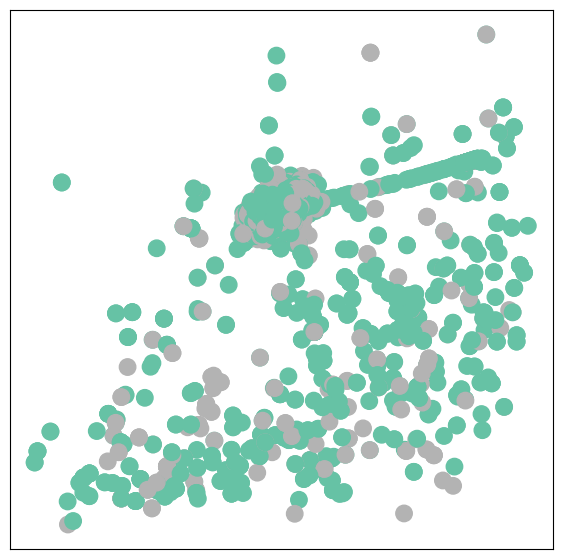

In [ ]:
#TESTING MODEL
model = GCN(0)

_, h = model(data.x, data.edge_index)
print(f'Embedding shape: {list(h.shape)}')

visualize_embedding(h, color=class_nums)

Embedding shape: [13240, 2]


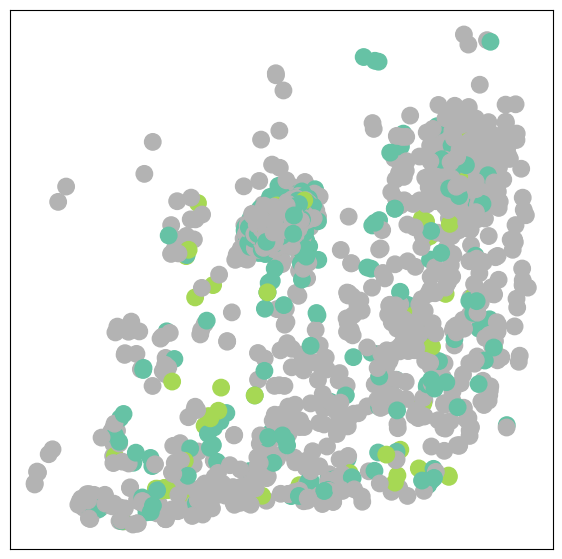

In [ ]:
#TESTING MODEL
model = GCN(1)

_, h = model(data2.x, data2.edge_index)
print(f'Embedding shape: {list(h.shape)}')

visualize_embedding(h, color=class_nums2)

Embedding shape: [13240, 2]


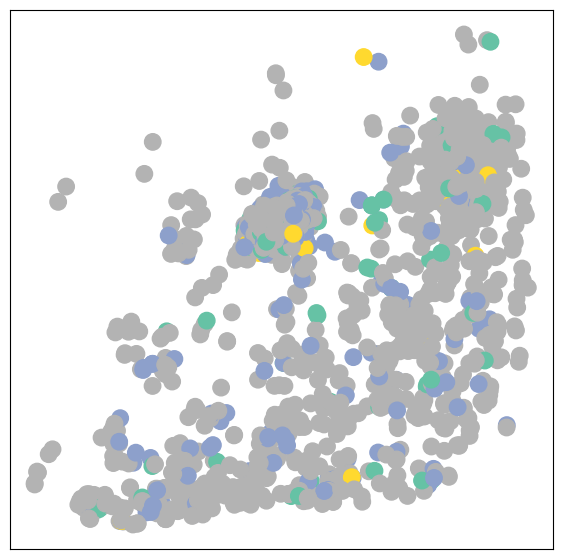

In [ ]:
#TESTING MODEL
model = GCN(2)

_, h = model(data3.x, data3.edge_index)
print(f'Embedding shape: {list(h.shape)}')

visualize_embedding(h, color=class_nums3)

In [ ]:
from torch.nn import Linear
from torch_geometric.nn import GCNConv
from torch_geometric.data import DataLoader
from sklearn.metrics import accuracy_score


# Define train and test masks
train_mask = torch.zeros(data.num_nodes, dtype=torch.bool)
train_mask[:int(0.8*data.num_nodes)] = 1
test_mask = torch.zeros(data.num_nodes, dtype=torch.bool)
test_mask[int(0.8*data.num_nodes):] = 1


<IPython.core.display.Javascript object>

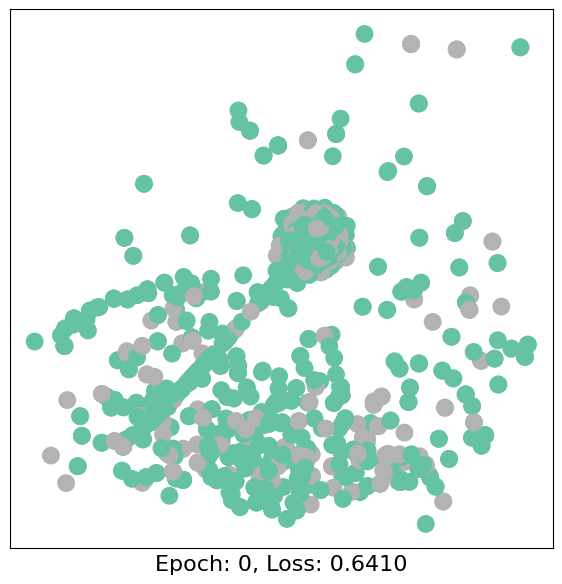

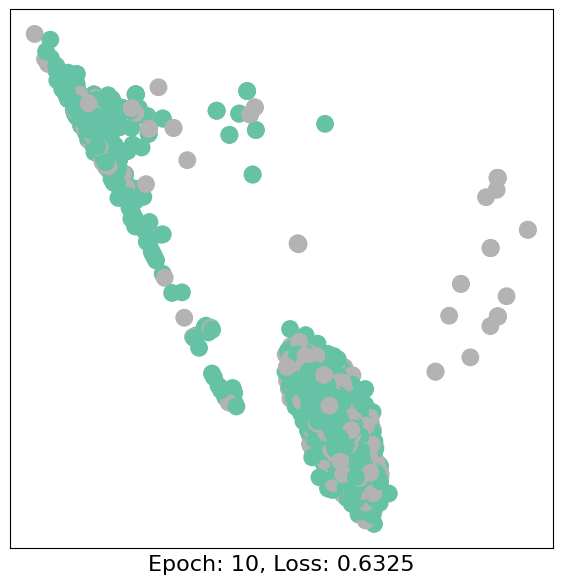

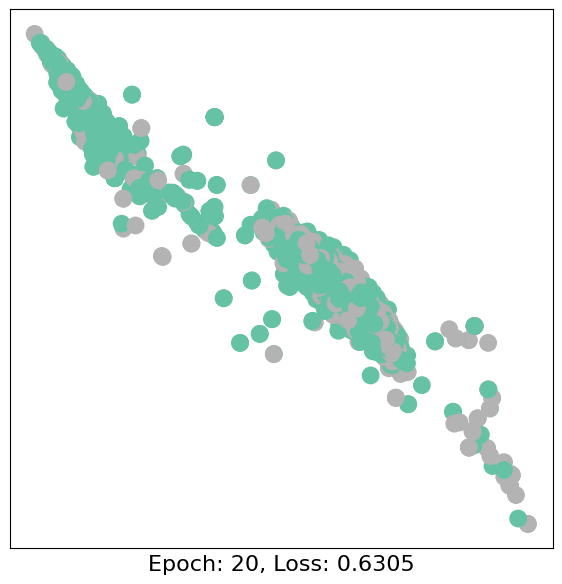

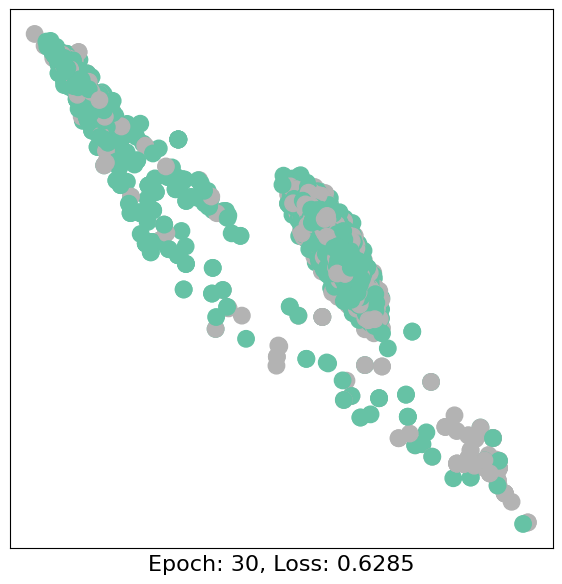

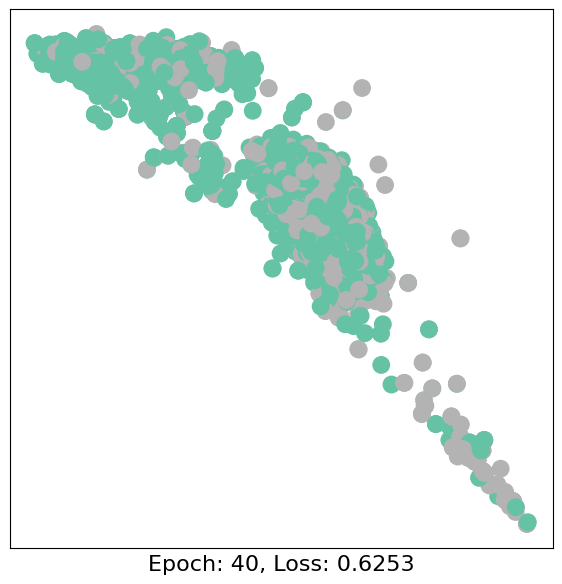

...

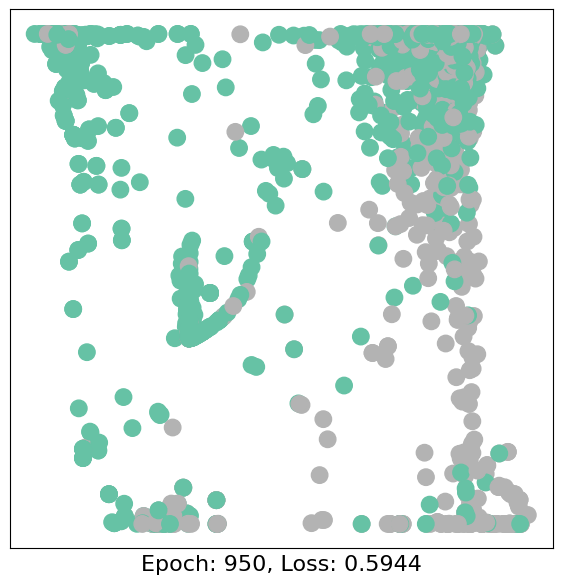

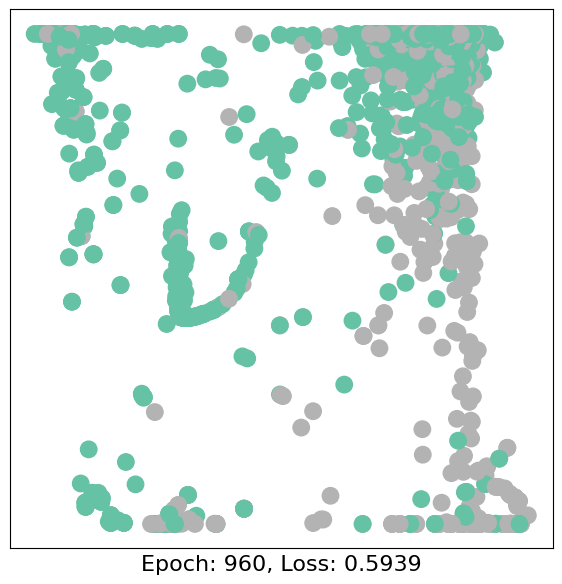

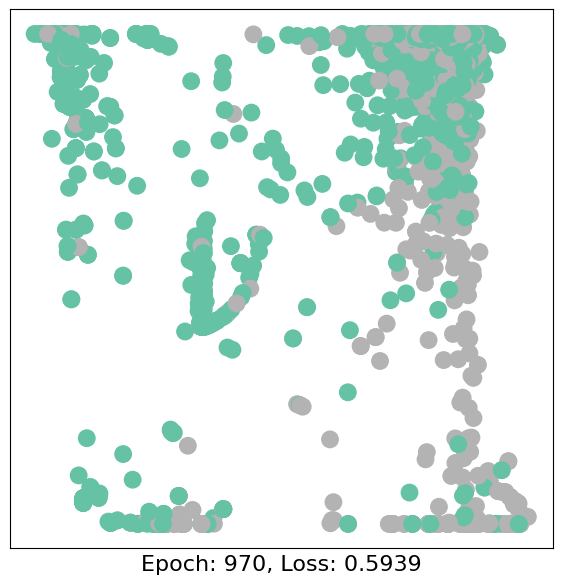

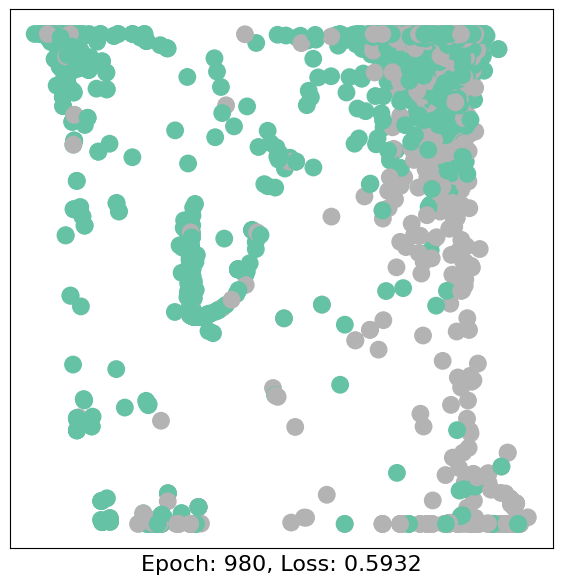

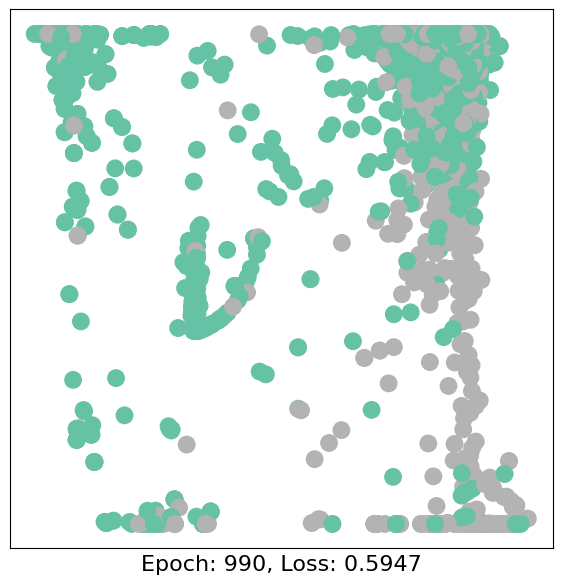

Test Accuracy: 0.6593655589123867


In [ ]:
import time
from IPython.display import Javascript  # Restrict height of output cell.
display(Javascript('''google.colab.output.setIframeHeight(0, true, {maxHeight: 430})'''))

model = GCN(0)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=0.02)  # Define optimizer with higher learning rate.

def train(data):
    model.train()
    optimizer.zero_grad()  # Clear gradients.
    out, h = model(data.x, data.edge_index)  # Perform a single forward pass.
    loss = criterion(out[train_mask], data.y[train_mask])  # Compute the loss solely based on the training nodes.
    loss.backward()  # Derive gradients.
    optimizer.step()  # Update parameters based on gradients.
    return loss, h

def test(data):
    model.eval()
    out, h = model(data.x, data.edge_index)
    y_pred = out.argmax(dim=-1)
    y_true = data.y[test_mask]
    acc = accuracy_score(y_true.cpu().numpy(), y_pred[test_mask].cpu().numpy())
    return acc

for epoch in range(1000):
    loss, h = train(data)
    if epoch % 10 == 0:
        visualize_embedding(h, color=data.y, epoch=epoch, loss=loss)
        time.sleep(0.3)

acc = test(data)
print(f'Test Accuracy: {acc}')

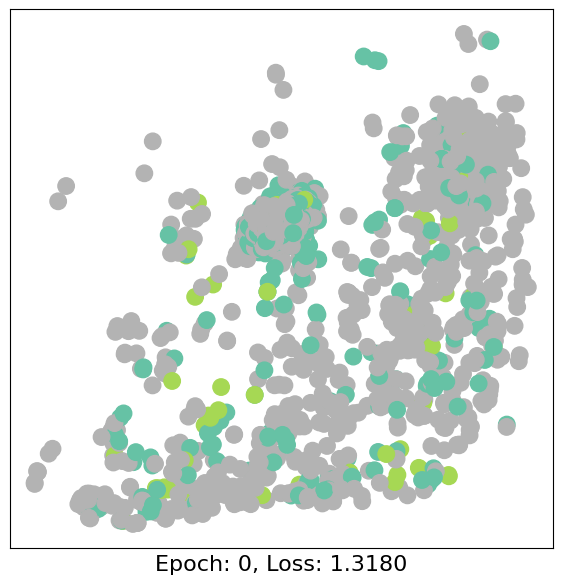

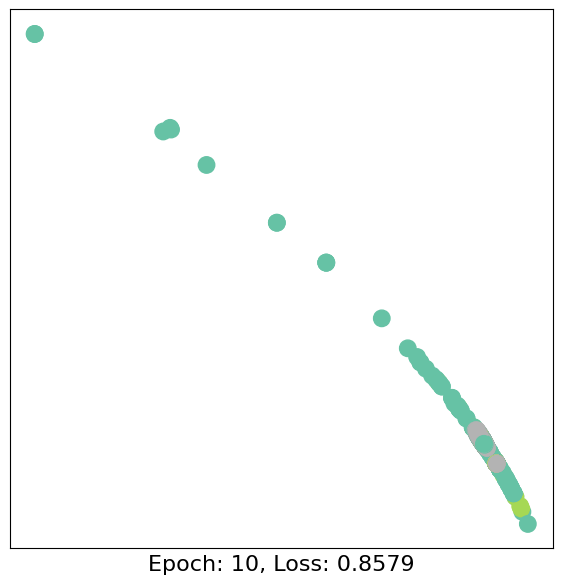

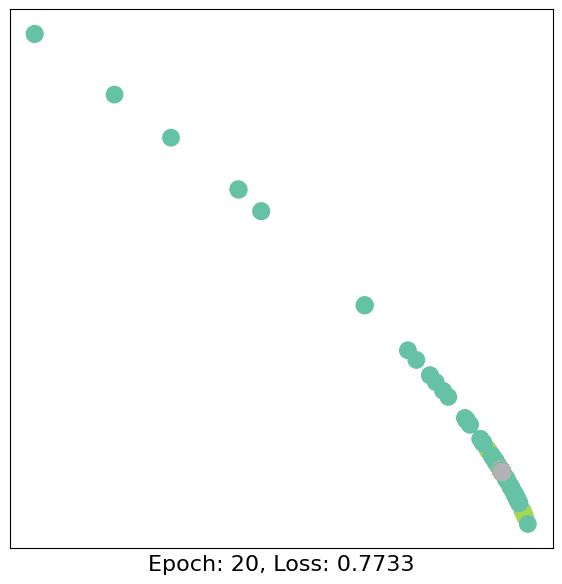

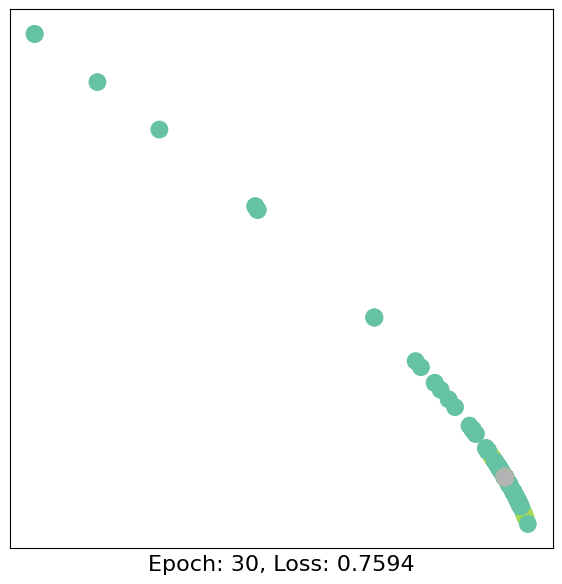

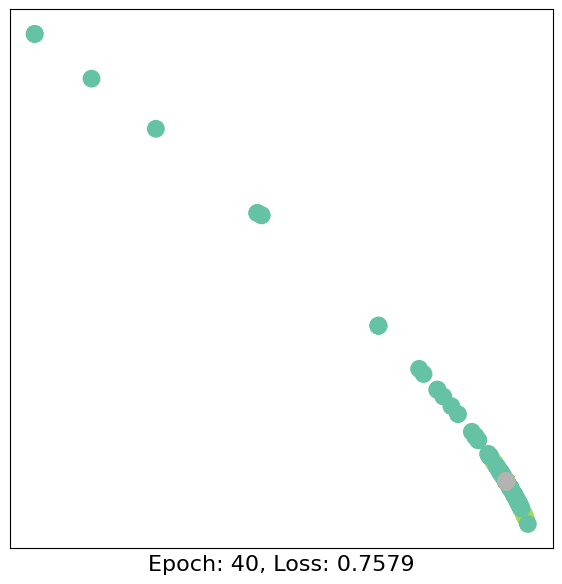

...

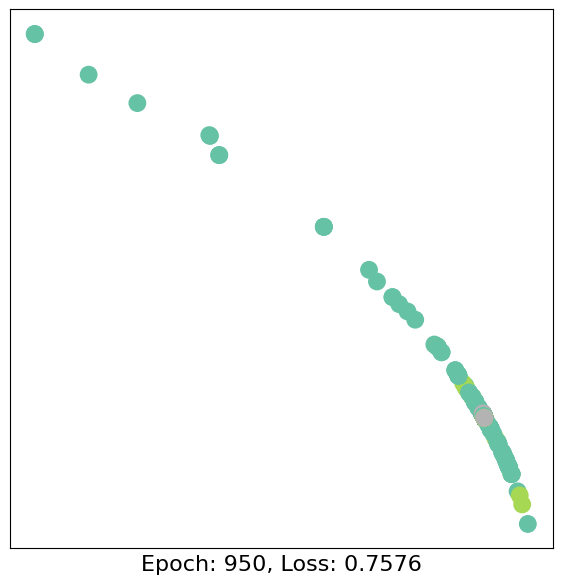

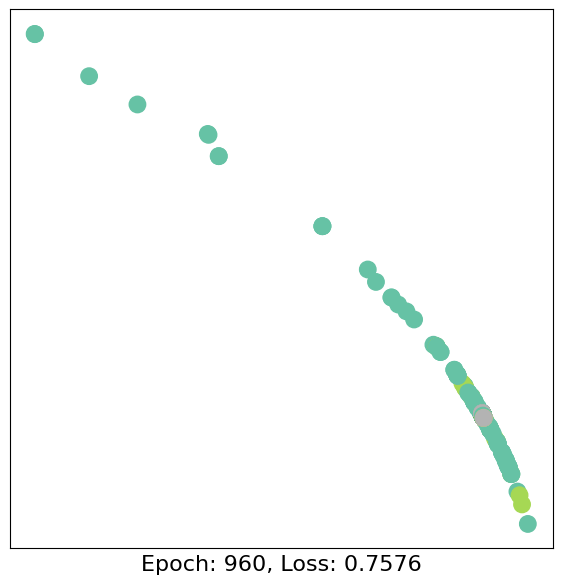

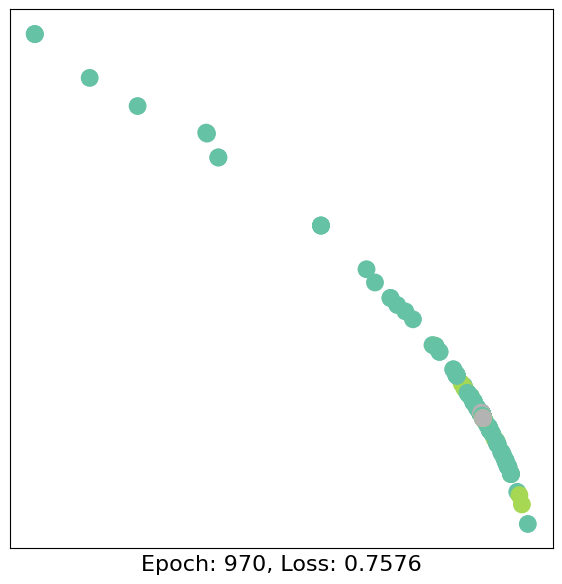

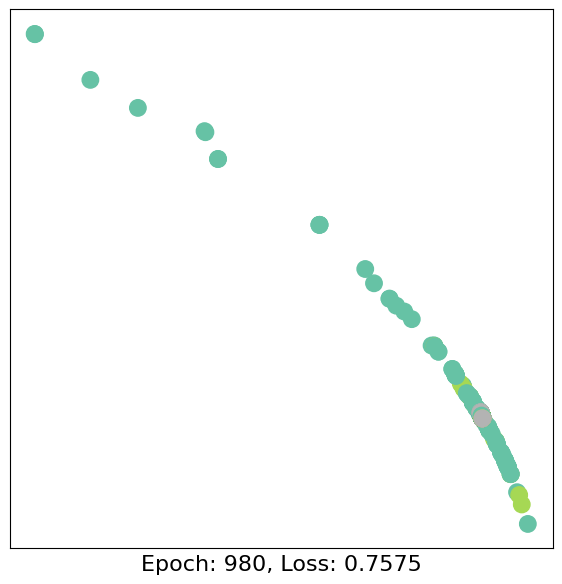

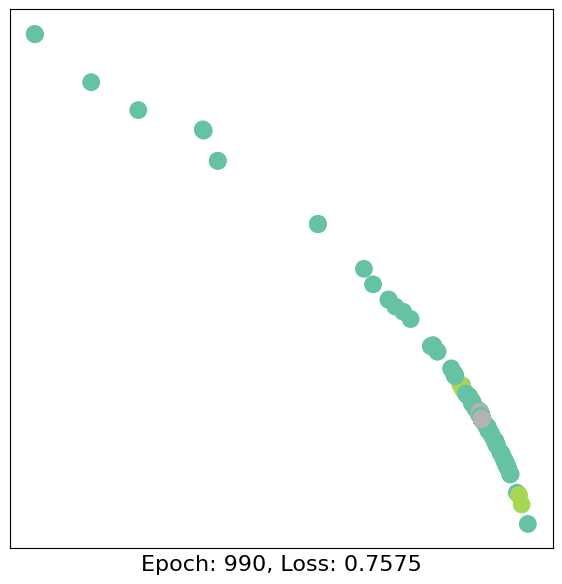

Test Accuracy: 0.6688066465256798


In [ ]:
model = GCN(1)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=0.02)  # Define optimizer with higher learning rate.
for epoch in range(1000):
    loss, h = train(data2)
    if epoch % 10 == 0:
        visualize_embedding(h, color=data2.y, epoch=epoch, loss=loss)
        time.sleep(0.3)

acc = test(data2)
print(f'Test Accuracy: {acc}')

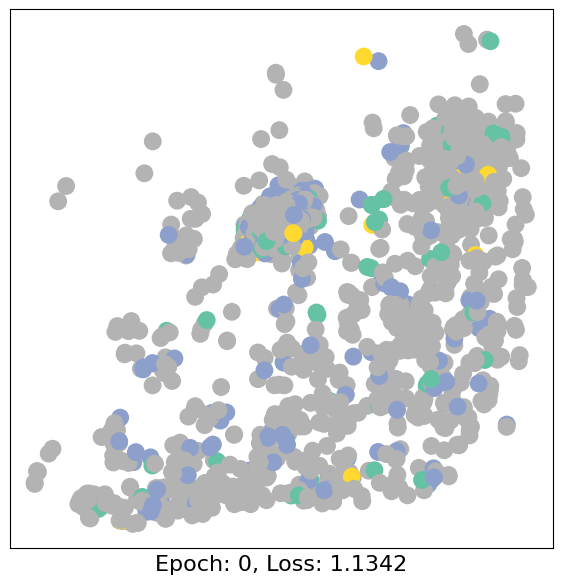

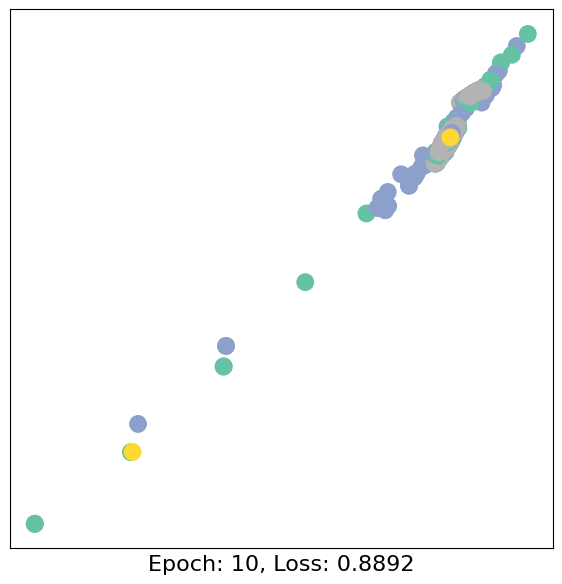

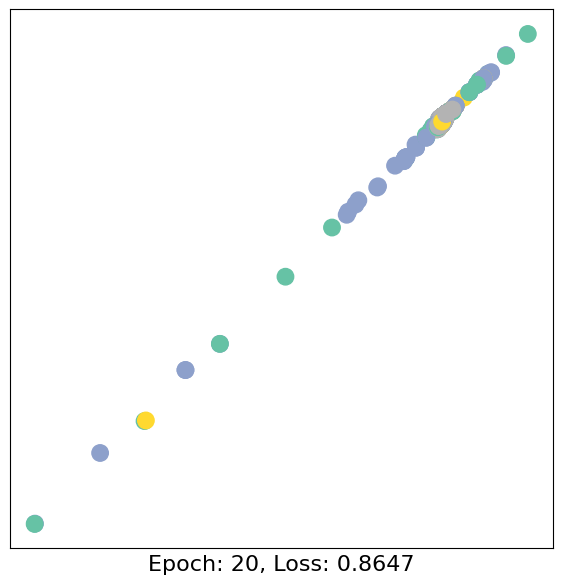

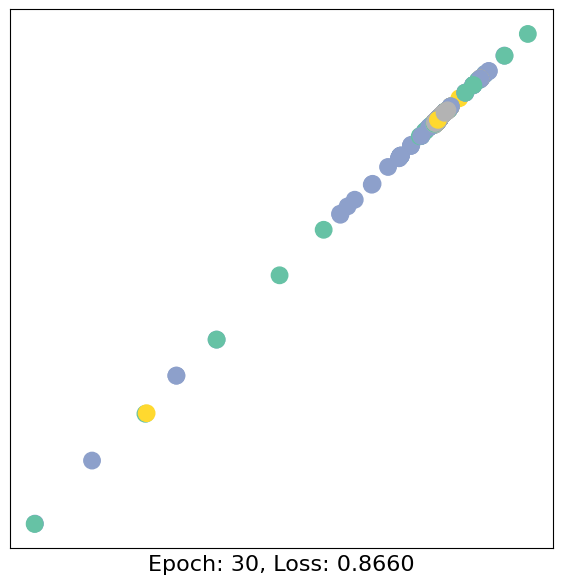

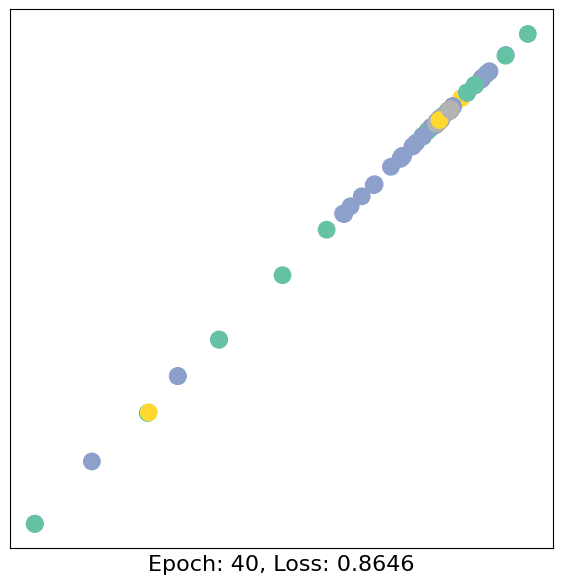

...

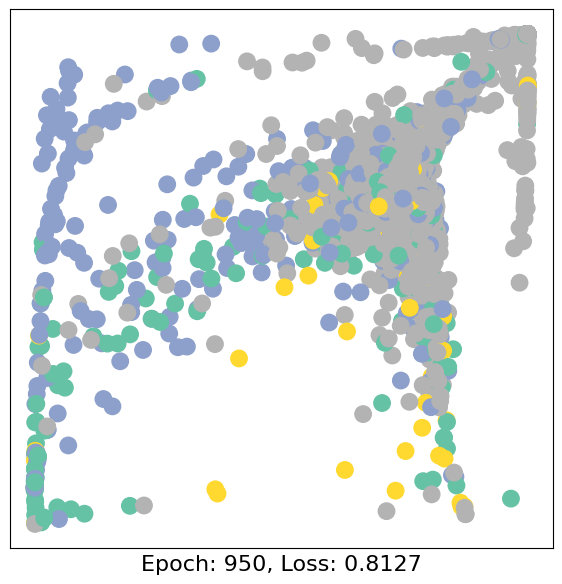

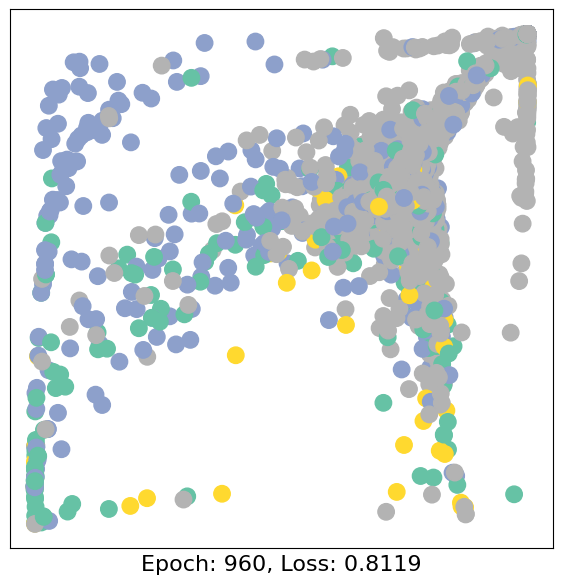

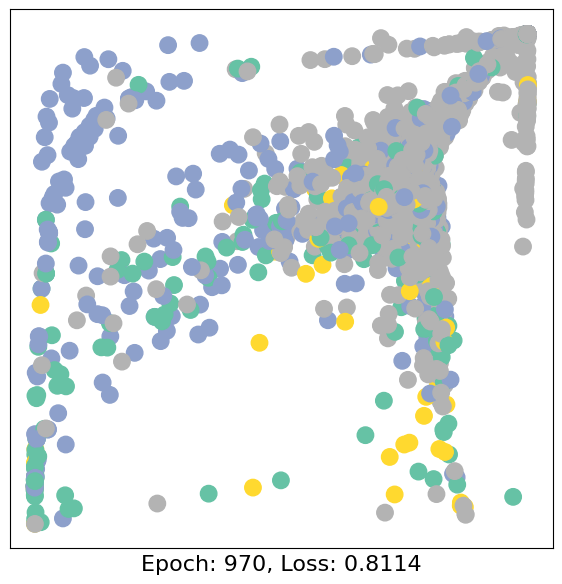

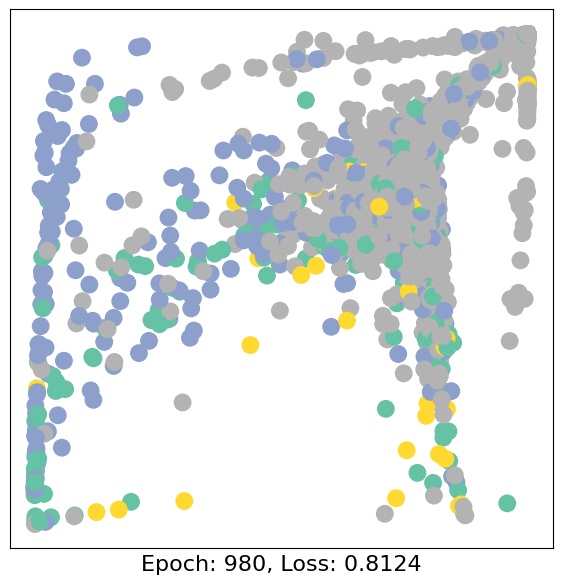

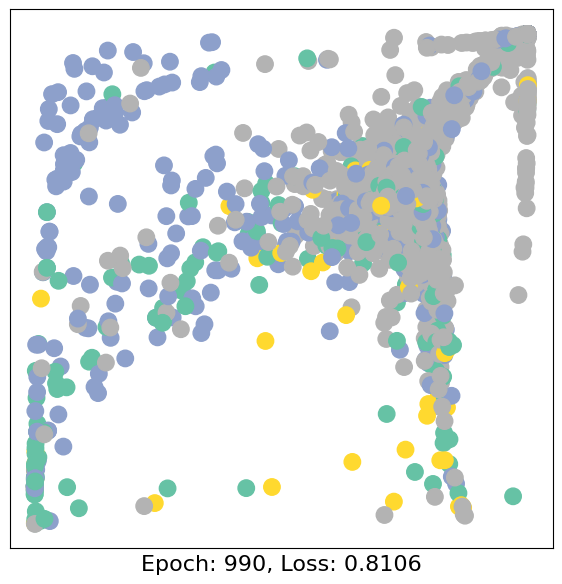

Test Accuracy: 0.7031722054380665


In [ ]:
model = GCN(2)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=0.02)  # Define optimizer with higher learning rate.
for epoch in range(1000):
    loss, h = train(data3)
    if epoch % 10 == 0:
        visualize_embedding(h, color=data3.y, epoch=epoch, loss=loss)
        time.sleep(0.3)

acc = test(data3)
print(f'Test Accuracy: {acc}')